In [1]:
import yfinance as yf
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [2]:
#Extracting stock dat from yahoo finance sector wise for 5 sectors
from datetime import datetime
time_duration = 269
dateList = []
datelist = pd.bdate_range(end=datetime.today(), periods=time_duration).tolist()
start_date = datelist[0].date()
end_date = datelist[-1].date()
bank = ['AXISBANK.NS','ICICIBANK.NS','HDFCBANK.NS','KOTAKBANK.NS','INDUSINDBK.NS','PNB.NS','BANKINDIA.NS','CANBK.NS','IOB.NS','BANKBARODA.NS']
pharma = ['PFIZER.NS','SANOFI.NS',"DRREDDY.NS","ASTRAZEN.NS",'ABBOTINDIA.NS']
engg = ['LTTS.NS','BEL.NS','KENNAMET.NS','ALPHAGEO.NS']
power = ['POWERGRID.NS','TORNTPOWER.NS','SWSOLAR.NS','ADANITRANS.NS','IEX.NS']
IT = ['INFY.NS','LTI.NS','OFSS.NS','TCS.NS']
stocks = bank + pharma + engg + power + IT
data = pd.DataFrame()
dfs = []

for stk in stocks:
    s1 = yf.download(stk,start=start_date,end=end_date)
    s1["stock"] = [stk for i in range(s1.shape[0])]
    dfs.append(s1)
data = pd.concat([df for df in dfs], ignore_index=True)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [3]:
#data is the initial data file with ohlc as columns and each stock's prices over a year one after another as rows
data.head()

,Open,High,Low,Close,Adj Close,Volume,stock
0,685.099976,689.349976,673.500000,678.200012,678.200012,5677087,AXISBANK.NS
1,674.000000,676.750000,658.900024,661.150024,661.150024,8753540,AXISBANK.NS
2,664.900024,668.599976,640.099976,663.900024,663.900024,17115901,AXISBANK.NS
3,658.799988,658.799988,641.450012,645.700012,645.700012,8461431,AXISBANK.NS
4,644.200012,653.000000,638.599976,647.299988,647.299988,10786466,AXISBANK.NS


In [4]:
data.shape

(7056, 7)

In [5]:
data.describe()

,Open,High,Low,Close,Adj Close,Volume
count,7056.000000,7056.000000,7056.000000,7056.000000,7056.000000,7.056000e+03
mean,1707.117041,1735.627876,1678.429895,1704.564596,1667.264767,7.655706e+06
std,2933.266185,2980.225171,2885.130361,2927.120332,2859.996314,1.368210e+07
min,6.850000,7.000000,6.050000,6.700000,6.700000,3.050000e+02
25%,170.037502,174.424999,166.000000,169.737499,166.782650,6.532050e+04
50%,631.100006,650.974976,614.049988,631.399994,624.123230,1.321236e+06
75%,1959.299988,1994.250000,1925.750031,1958.025024,1933.247009,9.421683e+06
max,18399.000000,18679.800781,18117.000000,18301.699219,17994.007812,2.868577e+08


In [6]:
#finding proportion among those stocks whose closing price is different from adjusted close price
data_dif_close = data[data['Close'] != data['Adj Close']]
print('Proportion of days when Adj Close price is different from Close price',np.round(len(data_dif_close)/len(data)*100,2),'%')
data_dif_close['stock'].value_counts(normalize=True)

Proportion of days when Adj Close price is different from Close price 42.5 %


POWERGRID.NS     0.083028
ABBOTINDIA.NS    0.082361
PFIZER.NS        0.081694
ASTRAZEN.NS      0.080027
TCS.NS           0.071691
DRREDDY.NS       0.070690
LTI.NS           0.070023
LTTS.NS          0.069690
SANOFI.NS        0.067356
INFY.NS          0.060353
OFSS.NS          0.058019
IEX.NS           0.045348
ALPHAGEO.NS      0.044348
SWSOLAR.NS       0.039680
TORNTPOWER.NS    0.038680
BEL.NS           0.037012
Name: stock, dtype: float64

In [7]:
#stock_name is a dataframe containing the stock names from data as one column of values
stock_name = pd.DataFrame()
stock_name["stock"] = data["stock"]
data.drop(columns='stock',axis=1,inplace=True)

In [8]:
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

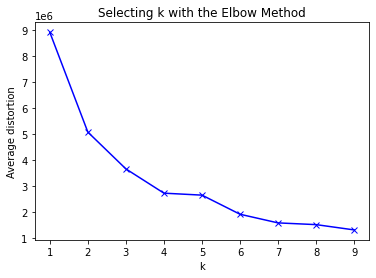

In [9]:
#Performing KMeans Clustering for data using ohlc columns
from scipy.spatial.distance import cdist
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(data)
    prediction=model.predict(data)
    meanDistortions.append(sum(np.min(cdist(data, model.cluster_centers_, 'euclidean'), axis=1)) / data
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [10]:
#Finding out the fitted value of data with the KMeans clustering
from scipy.stats import zscore
mydata_z = data.apply(zscore)
kmeans = KMeans(n_clusters=4, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)

KMeans(n_clusters=4, n_init=15, random_state=2345)

In [11]:
#Adding the cluster labels as another column to data
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
data = data.join(df_labels)
data["stock"] = stock_name["stock"]

In [12]:
#Printing the centroids
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,Open,High,Low,Close,Adj Close,Volume
0,-0.490988,-0.490025,-0.492081,-0.491184,-0.489798,2.163462
1,4.297392,4.299790,4.297390,4.299554,4.331641,-0.558439
2,0.836549,0.835886,0.837961,0.837027,0.817832,-0.542877
3,-0.348896,-0.349027,-0.349058,-0.349095,-0.346166,-0.221701


In [13]:
#Listing out the names of stocks and their proportions in each cluster
for label in range(1+np.max(list(data['labels'].values))):
    newdata = data[data.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
BANKBARODA.NS    0.227700
ICICIBANK.NS     0.197183
PNB.NS           0.171362
AXISBANK.NS      0.134977
INDUSINDBK.NS    0.085681
HDFCBANK.NS      0.045775
BEL.NS           0.045775
CANBK.NS         0.030516
POWERGRID.NS     0.029343
INFY.NS          0.019953
BANKINDIA.NS     0.005869
IOB.NS           0.005869
Name: stock, dtype: float64
1
ABBOTINDIA.NS    1.0
Name: stock, dtype: float64
2
DRREDDY.NS       0.209825
PFIZER.NS        0.209825
SANOFI.NS        0.209825
OFSS.NS          0.176520
ASTRAZEN.NS      0.170691
LTI.NS           0.020816
ABBOTINDIA.NS    0.002498
Name: stock, dtype: float64
3
LTTS.NS          0.053008
TORNTPOWER.NS    0.053008
TCS.NS           0.053008
KOTAKBANK.NS     0.053008
KENNAMET.NS      0.053008
IEX.NS           0.053008
ALPHAGEO.NS      0.053008
ADANITRANS.NS    0.053008
SWSOLAR.NS       0.053008
BANKINDIA.NS     0.051956
IOB.NS           0.051956
INFY.NS          0.049432
POWERGRID.NS     0.047749
LTI.NS           0.047749
CANBK.NS         0.047539
BEL

In [14]:
#data_2 has only adj closing price
data_2 = pd.DataFrame()
data_2["Adj Close"] = data["Adj Close"]


In [15]:
data_2.head()

,Adj Close
0,678.200012
1,661.150024
2,663.900024
3,645.700012
4,647.299988


Text(0.5, 1.0, 'Selecting k with the Elbow Method')

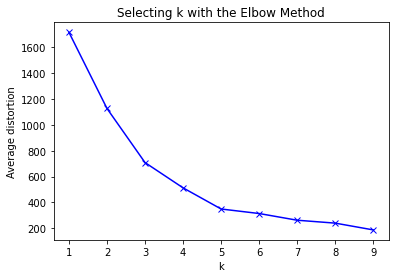

In [16]:
#Performing KMeans clustering for data_2 using only one variable - adj close price
#from scipy.spatial.distance import cdist
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(data_2)
    prediction=model.predict(data_2)
    meanDistortions.append(sum(np.min(cdist(data_2, model.cluster_centers_, 'euclidean'), axis=1)) / data_2
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [17]:
#Adding cluster labels to data_2 after choosing number of clusters
mydata_z = data_2.apply(zscore)
kmeans = KMeans(n_clusters=5, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
data_2 = data_2.join(df_labels)
data_2["stock"] = stock_name["stock"]

In [18]:
data_2.head()

,Adj Close,labels,stock
0,678.200012,0,AXISBANK.NS
1,661.150024,0,AXISBANK.NS
2,663.900024,0,AXISBANK.NS
3,645.700012,0,AXISBANK.NS
4,647.299988,0,AXISBANK.NS


In [19]:
#Printing the centroids
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,Adj Close
0,-0.494277
1,4.535052
2,-0.049586
3,1.934435
4,0.561276


In [20]:
#Listing out stocks and their proportions in each cluster
for label in range(1+np.max(list(data_2['labels'].values))):
    newdata = data_2[data_2.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
AXISBANK.NS      0.062906
BANKINDIA.NS     0.062906
BEL.NS           0.062906
PNB.NS           0.062906
IEX.NS           0.062906
ICICIBANK.NS     0.062906
BANKBARODA.NS    0.062906
ALPHAGEO.NS      0.062906
CANBK.NS         0.062906
TORNTPOWER.NS    0.062906
POWERGRID.NS     0.062906
IOB.NS           0.062906
ADANITRANS.NS    0.062906
SWSOLAR.NS       0.062906
INFY.NS          0.053669
INDUSINDBK.NS    0.030454
KENNAMET.NS      0.030454
HDFCBANK.NS      0.004743
Name: stock, dtype: float64
1
ABBOTINDIA.NS    1.0
Name: stock, dtype: float64
2
LTTS.NS          0.156619
KOTAKBANK.NS     0.156619
TCS.NS           0.156619
HDFCBANK.NS      0.144810
LTI.NS           0.141703
INDUSINDBK.NS    0.080796
KENNAMET.NS      0.080796
OFSS.NS          0.029832
ASTRAZEN.NS      0.029211
INFY.NS          0.022996
Name: stock, dtype: float64
3
SANOFI.NS        0.874126
ABBOTINDIA.NS    0.125874
Name: stock, dtype: float64
4
DRREDDY.NS     0.268371
PFIZER.NS      0.268371
ASTRAZEN.NS    0.218317
OFSS.

In [21]:
kmeans.cluster_centers_

array([[-0.49427702],
       [ 4.53505246],
       [-0.04958598],
       [ 1.93443459],
       [ 0.56127578]])

In [22]:
#data_3 is the dataframe that has each row indicating a particular date and each column as a company name.
data_3 = pd.DataFrame()
time_duration = int(data.shape[0]/len(stocks))
for i in range(len(stocks)) :
    data_3[stocks[i]] = np.array(data_2.iloc[time_duration*i:time_duration+time_duration*i,0])

In [23]:
#data_4 has columns that indicate each date and rows belonging to each stock
data_4 = data_3.transpose()
data_4.head(10)

,0,1,2,3,4,5,6,7,8,9,...,242,243,244,245,246,247,248,249,250,251
AXISBANK.NS,678.200012,661.150024,663.900024,645.700012,647.299988,649.599976,671.099976,671.549988,681.700012,662.900024,...,445.799988,451.799988,463.350006,473.049988,509.200012,496.750000,485.700012,484.399994,474.950012,455.200012
ICICIBANK.NS,412.950012,404.399994,409.649994,392.149994,397.500000,389.000000,391.350006,395.450012,394.600006,402.700012,...,380.350006,386.350006,389.350006,392.200012,409.700012,394.600006,390.950012,392.399994,382.750000,372.549988
HDFCBANK.NS,1123.750000,1113.469971,1113.969971,1105.469971,1123.880005,1117.569946,1122.949951,1124.800049,1125.650024,1135.430054,...,1117.050049,1119.699951,1118.449951,1112.099976,1114.500000,1115.849976,1127.300049,1134.150024,1130.900024,1119.300049
KOTAKBANK.NS,1483.650024,1450.849976,1431.449951,1414.300049,1426.449951,1410.150024,1441.550049,1471.300049,1475.199951,1457.550049,...,1387.250000,1400.099976,1436.699951,1420.000000,1467.099976,1401.349976,1430.650024,1423.500000,1396.699951,1380.050049
INDUSINDBK.NS,1365.849976,1350.550049,1395.750000,1343.949951,1317.599976,1308.099976,1331.099976,1335.000000,1372.150024,1390.250000,...,529.150024,536.500000,567.650024,605.849976,665.650024,630.200012,627.450012,640.549988,631.849976,616.150024
PNB.NS,65.650002,65.050003,64.900002,59.400002,59.900002,61.099998,61.299999,62.599998,64.849998,64.550003,...,35.299999,35.200001,35.400002,35.299999,37.049999,35.049999,34.700001,34.799999,34.500000,33.650002
BANKINDIA.NS,67.699997,65.900002,65.550003,62.849998,63.849998,63.700001,63.700001,66.099998,68.150002,68.250000,...,47.900002,47.750000,48.400002,49.900002,52.549999,54.349998,52.099998,51.400002,50.549999,48.549999
CANBK.NS,226.899994,220.600006,220.600006,197.000000,192.649994,191.550003,191.699997,197.949997,204.500000,203.500000,...,103.500000,106.699997,106.300003,105.550003,114.800003,107.500000,106.750000,107.750000,106.300003,103.250000
IOB.NS,10.100000,10.000000,10.450000,10.150000,10.000000,10.050000,9.950000,9.850000,10.150000,10.000000,...,11.150000,10.850000,10.900000,10.900000,11.050000,10.600000,10.450000,10.400000,10.350000,10.250000
BANKBARODA.NS,94.500000,91.800003,92.599998,91.449997,93.300003,93.750000,94.400002,95.550003,99.050003,101.099998,...,48.349998,48.700001,48.450001,48.700001,51.599998,48.950001,47.549999,47.250000,47.299999,45.900002


In [24]:
#Applying PCA to data containing only Adjusted Close price
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principal_comp = pca.fit_transform(data_4)
principal_data = pd.DataFrame(data = principal_comp, columns = ['principal component 1', 'principal component 2'])
principal_data['stock'] = stocks
principal_data

,principal component 1,principal component 2,stock
0,-17726.118249,552.551512,AXISBANK.NS
1,-19902.284943,-888.284116,ICICIBANK.NS
2,-9176.613861,1643.701766,HDFCBANK.NS
3,-3773.662259,2724.138176,KOTAKBANK.NS
4,-12778.919123,5569.443333,INDUSINDBK.NS
5,-25729.719748,-2352.938084,PNB.NS
6,-25610.102057,-2335.983809,BANKINDIA.NS
7,-24206.570522,-1573.781214,CANBK.NS
8,-26282.636475,-2621.792609,IOB.NS
9,-25363.287863,-2186.179972,BANKBARODA.NS


In [25]:
#Dropping stock name column so as to run KMeans algorithm
principal_data.drop(columns='stock',axis=1,inplace=True)

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

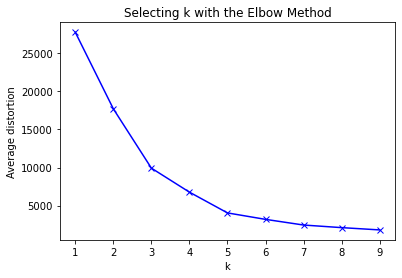

In [26]:
#clustering the principal data based on 2 principal components
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(principal_data)
    prediction=model.predict(principal_data)
    meanDistortions.append(sum(np.min(cdist(principal_data, model.cluster_centers_, 'euclidean'), axis=1)) / principal_data
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [27]:
mydata_z = principal_data.apply(zscore)
kmeans = KMeans(n_clusters=5, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
principal_data = mydata_z.join(df_labels)
principal_data['stock'] = stocks
principal_data

,principal component 1,principal component 2,labels,stock
0,-0.392102,0.208288,1,AXISBANK.NS
1,-0.440239,-0.334845,0,ICICIBANK.NS
2,-0.202987,0.619605,1,HDFCBANK.NS
3,-0.083473,1.026883,1,KOTAKBANK.NS
4,-0.282670,2.099442,4,INDUSINDBK.NS
5,-0.569142,-0.886957,0,PNB.NS
6,-0.566496,-0.880566,0,BANKINDIA.NS
7,-0.535450,-0.593248,0,CANBK.NS
8,-0.581373,-0.988304,0,IOB.NS
9,-0.561036,-0.824096,0,BANKBARODA.NS


In [28]:
#Centroids Data
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,principal component 1,principal component 2
0,-0.437730,-0.662308
1,0.035456,0.630233
2,4.396260,-1.709277
3,1.808423,1.312608
4,0.021084,2.329597


<Figure size 432x288 with 0 Axes>

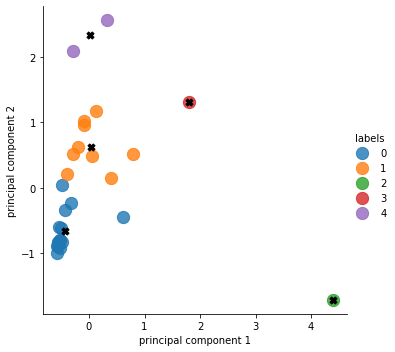

In [29]:
#Clustering based on principal components and only adjusted close price
plt.figure()
facet = sns.lmplot(data=principal_data, x='principal component 1', y='principal component 2', hue='labels', 
                   fit_reg=False, legend=True, legend_out=True,scatter_kws={"s": 150})
for i in range(len(centroid_df)) :
    plt.scatter(centroid_df.iloc[i]['principal component 1'],centroid_df.iloc[i]['principal component 2'],marker='X',c='black',s=50)

In [30]:
#Above shown cluster represented as list data
for label in range(1+np.max(list(principal_data['labels'].values))):
    newdata = principal_data[principal_data.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
SWSOLAR.NS       0.066667
INFY.NS          0.066667
PNB.NS           0.066667
IEX.NS           0.066667
CANBK.NS         0.066667
BANKINDIA.NS     0.066667
TORNTPOWER.NS    0.066667
BEL.NS           0.066667
ADANITRANS.NS    0.066667
BANKBARODA.NS    0.066667
POWERGRID.NS     0.066667
ICICIBANK.NS     0.066667
DRREDDY.NS       0.066667
IOB.NS           0.066667
ALPHAGEO.NS      0.066667
Name: stock, dtype: float64
1
KENNAMET.NS     0.111111
AXISBANK.NS     0.111111
HDFCBANK.NS     0.111111
LTTS.NS         0.111111
ASTRAZEN.NS     0.111111
LTI.NS          0.111111
TCS.NS          0.111111
KOTAKBANK.NS    0.111111
PFIZER.NS       0.111111
Name: stock, dtype: float64
2
ABBOTINDIA.NS    1.0
Name: stock, dtype: float64
3
SANOFI.NS    1.0
Name: stock, dtype: float64
4
OFSS.NS          0.5
INDUSINDBK.NS    0.5
Name: stock, dtype: float64


In [31]:
#pct_data contains the columns as each stock name and rows as dates with each value holding the percent change in adj close price
pct_data = data_3.pct_change().drop(index=0,axis=0)

In [32]:
pct_data = pct_data.transpose()

In [33]:
pct_data

,1,2,3,4,5,6,7,8,9,10,...,242,243,244,245,246,247,248,249,250,251
AXISBANK.NS,-0.025140,0.004159,-0.027414,0.002478,0.003553,0.033097,0.000671,0.015114,-0.027578,0.017122,...,0.012147,0.013459,0.025564,0.020934,0.076419,-0.024450,-0.022245,-0.002677,-0.019509,-0.041583
ICICIBANK.NS,-0.020705,0.012982,-0.042719,0.013643,-0.021384,0.006041,0.010477,-0.002149,0.020527,0.026571,...,0.024788,0.015775,0.007765,0.007320,0.044620,-0.036856,-0.009250,0.003709,-0.024592,-0.026649
HDFCBANK.NS,-0.009148,0.000449,-0.007630,0.016654,-0.005615,0.004814,0.001648,0.000756,0.008688,-0.005910,...,0.028923,0.002372,-0.001116,-0.005677,0.002158,0.001211,0.010261,0.006076,-0.002866,-0.010257
KOTAKBANK.NS,-0.022108,-0.013371,-0.011981,0.008591,-0.011427,0.022267,0.020638,0.002651,-0.011964,0.018318,...,0.035725,0.009263,0.026141,-0.011624,0.033169,-0.044816,0.020908,-0.004998,-0.018827,-0.011921
INDUSINDBK.NS,-0.011202,0.033468,-0.037113,-0.019606,-0.007210,0.017583,0.002930,0.027828,0.013191,0.006006,...,0.030377,0.013890,0.058062,0.067295,0.098704,-0.053256,-0.004364,0.020878,-0.013582,-0.024848
PNB.NS,-0.009139,-0.002306,-0.084746,0.008418,0.020033,0.003273,0.021207,0.035942,-0.004626,0.005422,...,-0.009818,-0.002833,0.005682,-0.002825,0.049575,-0.053981,-0.009986,0.002882,-0.008621,-0.024638
BANKINDIA.NS,-0.026588,-0.005311,-0.041190,0.015911,-0.002349,0.000000,0.037677,0.031014,0.001467,0.012454,...,-0.006224,-0.003132,0.013613,0.030992,0.053106,0.034253,-0.041398,-0.013436,-0.016537,-0.039565
CANBK.NS,-0.027765,0.000000,-0.106981,-0.022081,-0.005710,0.000783,0.032603,0.033089,-0.004890,-0.000491,...,-0.007670,0.030918,-0.003749,-0.007056,0.087636,-0.063589,-0.006977,0.009368,-0.013457,-0.028692
IOB.NS,-0.009901,0.045000,-0.028708,-0.014778,0.005000,-0.009950,-0.010050,0.030457,-0.014778,0.000000,...,-0.047009,-0.026906,0.004608,0.000000,0.013762,-0.040724,-0.014151,-0.004785,-0.004808,-0.009662
BANKBARODA.NS,-0.028571,0.008715,-0.012419,0.020230,0.004823,0.006933,0.012182,0.036630,0.020697,-0.011375,...,0.000000,0.007239,-0.005133,0.005160,0.059548,-0.051357,-0.028601,-0.006309,0.001058,-0.029598


In [34]:
#Applying PCA to percentage change of adj close price data
pca = PCA(n_components=2)
principal_comp = pca.fit_transform(pct_data)
pct_data = pd.DataFrame(data = principal_comp, columns = ['principal component 1', 'principal component 2'])

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

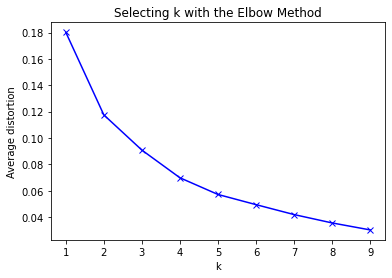

In [35]:
#clustering pct data 
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(pct_data)
    prediction=model.predict(pct_data)
    meanDistortions.append(sum(np.min(cdist(pct_data, model.cluster_centers_, 'euclidean'), axis=1)) / pct_data
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [36]:
mydata_z = pct_data.apply(zscore)
kmeans = KMeans(n_clusters=5, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
pct_data = mydata_z.join(df_labels)
pct_data['stock'] = stocks

In [37]:
pct_data.head()

,principal component 1,principal component 2,labels,stock
0,1.838605,0.093381,3,AXISBANK.NS
1,1.248209,0.116809,3,ICICIBANK.NS
2,0.472701,-0.042966,3,HDFCBANK.NS
3,0.538275,-0.439666,3,KOTAKBANK.NS
4,3.866097,-1.396186,2,INDUSINDBK.NS


In [38]:
#Centroids Data
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,principal component 1,principal component 2
0,0.308098,1.686672
1,-0.516224,-0.752468
2,3.866097,-1.396186
3,1.024448,-0.068110
4,-0.558692,0.603470


<Figure size 432x288 with 0 Axes>

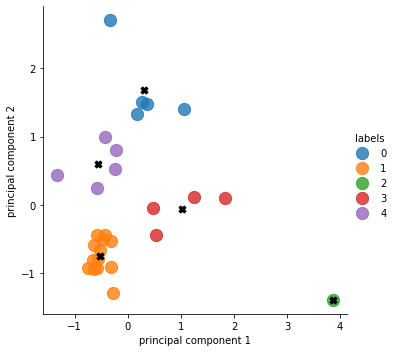

In [39]:
#Clusters plot
plt.figure()
facet = sns.lmplot(data=pct_data, x='principal component 1', y='principal component 2', hue='labels', 
                   fit_reg=False, legend=True, legend_out=True,scatter_kws={"s": 150})
for i in range(len(centroid_df)) :
    plt.scatter(centroid_df.iloc[i]['principal component 1'],centroid_df.iloc[i]['principal component 2'],marker='X',c='black',s=50)

In [40]:
#Above shown clusters represented in list form
for label in range(1+np.max(list(pct_data['labels'].values))):
    newdata = pct_data[pct_data.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
CANBK.NS         0.2
BANKINDIA.NS     0.2
ALPHAGEO.NS      0.2
BANKBARODA.NS    0.2
PNB.NS           0.2
Name: stock, dtype: float64
1
KENNAMET.NS      0.076923
INFY.NS          0.076923
LTTS.NS          0.076923
PFIZER.NS        0.076923
ABBOTINDIA.NS    0.076923
TORNTPOWER.NS    0.076923
LTI.NS           0.076923
SANOFI.NS        0.076923
ASTRAZEN.NS      0.076923
POWERGRID.NS     0.076923
DRREDDY.NS       0.076923
TCS.NS           0.076923
OFSS.NS          0.076923
Name: stock, dtype: float64
2
INDUSINDBK.NS    1.0
Name: stock, dtype: float64
3
AXISBANK.NS     0.25
ICICIBANK.NS    0.25
HDFCBANK.NS     0.25
KOTAKBANK.NS    0.25
Name: stock, dtype: float64
4
SWSOLAR.NS       0.2
BEL.NS           0.2
ADANITRANS.NS    0.2
IOB.NS           0.2
IEX.NS           0.2
Name: stock, dtype: float64


In [41]:
#Preparing a percentage change data for Effective Frontier Analysis
data_3 = data_3.pct_change()
data_3.drop(index=0,axis=0,inplace=True)
data_3

,AXISBANK.NS,ICICIBANK.NS,HDFCBANK.NS,KOTAKBANK.NS,INDUSINDBK.NS,PNB.NS,BANKINDIA.NS,CANBK.NS,IOB.NS,BANKBARODA.NS,...,ALPHAGEO.NS,POWERGRID.NS,TORNTPOWER.NS,SWSOLAR.NS,ADANITRANS.NS,IEX.NS,INFY.NS,LTI.NS,OFSS.NS,TCS.NS
1,-0.025140,-0.020705,-0.009148,-0.022108,-0.011202,-0.009139,-0.026588,-0.027765,-0.009901,-0.028571,...,0.025829,-0.004617,-0.013886,-0.009986,0.005751,0.001899,0.005545,-0.005092,-0.005172,-0.002590
2,0.004159,0.012982,0.000449,-0.013371,0.033468,-0.002306,-0.005311,0.000000,0.045000,0.008715,...,0.038756,-0.020996,0.003791,-0.015736,-0.008259,0.020470,0.009852,-0.003095,0.030125,0.011708
3,-0.027414,-0.042719,-0.007630,-0.011981,-0.037113,-0.084746,-0.041190,-0.106981,-0.028708,-0.012419,...,-0.024953,-0.017207,-0.017086,-0.058949,0.002990,-0.002600,-0.000798,-0.010637,-0.008747,-0.003540
4,0.002478,0.013643,0.016654,0.008591,-0.019606,0.008418,0.015911,-0.022081,-0.014778,0.020230,...,-0.020229,-0.000761,-0.009698,-0.009322,0.005110,0.002607,0.008658,0.023553,0.002521,-0.002754
5,0.003553,-0.021384,-0.005615,-0.011427,-0.007210,0.020033,-0.002349,-0.005710,0.005000,0.004823,...,-0.007214,0.012443,0.005913,-0.005101,0.007202,0.002972,0.015524,0.011232,-0.006271,-0.013405
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,-0.024450,-0.036856,0.001211,-0.044816,-0.053256,-0.053981,0.034253,-0.063589,-0.040724,-0.051357,...,-0.068096,-0.018376,-0.033952,-0.056551,-0.081081,0.000259,-0.007110,-0.024309,-0.003156,0.008354
248,-0.022245,-0.009250,0.010261,0.020908,-0.004364,-0.009986,-0.041398,-0.006977,-0.014151,-0.028601,...,-0.010480,0.008103,0.023881,0.002770,0.040268,-0.004148,-0.015561,0.005410,-0.020049,-0.004829
249,-0.002677,0.003709,0.006076,-0.004998,0.020878,0.002882,-0.013436,0.009368,-0.004785,-0.006309,...,0.006178,0.027444,0.000147,0.008877,0.044592,0.004947,0.010775,0.003055,-0.003988,0.008369
250,-0.019509,-0.024592,-0.002866,-0.018827,-0.013582,-0.008621,-0.016537,-0.013457,-0.004808,0.001058,...,0.010526,-0.014901,-0.008947,0.005671,0.002725,0.010622,0.012500,0.003650,-0.008260,0.015165


In [42]:
#Effective Frontier Analysis - Choosing the best stock from each sector based on the risk adjusted return
fixed_rate = 3.59/100
annual_return = []
final_stock = []
volatility = []

risk_return = []
for p in pharma:
    risk_return.append(((np.mean(data_3[p])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[p]))
p = risk_return.index(np.max(risk_return))
final_stock.append(pharma[p])
annual_return.append((np.mean(data_3[pharma[p]])+1)**time_duration - 1)
volatility.append(np.std(data_3[pharma[p]])*np.sqrt(time_duration))

risk_return = []
for e in engg:
    risk_return.append(((np.mean(data_3[e])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[e]))
e = risk_return.index(np.max(risk_return))
final_stock.append(engg[e])
annual_return.append((np.mean(data_3[engg[e]])+1)**time_duration - 1)
volatility.append(np.std(data_3[engg[e]])*np.sqrt(time_duration))

risk_return = []
for p in power:
    risk_return.append(((np.mean(data_3[p])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[p]))
p = risk_return.index(np.max(risk_return))
final_stock.append(power[p])
annual_return.append((np.mean(data_3[power[p]])+1)**time_duration - 1)
volatility.append(np.std(data_3[power[p]])*np.sqrt(time_duration))

sample_return = []
risk_return = []
for i in IT:
    risk_return.append(((np.mean(data_3[i])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[i]))
    sample_return.append((np.mean(data_3[i])+1)**time_duration - 1)
i = risk_return.index(np.max(risk_return))
final_stock.append(IT[i])
annual_return.append((np.mean(data_3[IT[i]])+1)**time_duration - 1)
volatility.append(np.std(data_3[IT[i]])*np.sqrt(time_duration))

risk_return = []
for b in bank:
    risk_return.append(((np.mean(data_3[b])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[b]))
b = risk_return.index(np.max(risk_return))
final_stock.append(bank[b])
annual_return.append((np.mean(data_3[bank[b]])+1)**time_duration - 1)
volatility.append(np.std(data_3[bank[b]])*np.sqrt(time_duration))

choosen_data = pd.DataFrame()
choosen_data['stock'] = final_stock
choosen_data['annual return'] = annual_return
choosen_data['volatility'] = volatility
choosen_data


,stock,annual return,volatility
0,ASTRAZEN.NS,1.439563,0.532459
1,BEL.NS,0.188088,0.507106
2,IEX.NS,0.635223,0.446923
3,LTI.NS,0.653326,0.380579
4,IOB.NS,0.141159,0.491258


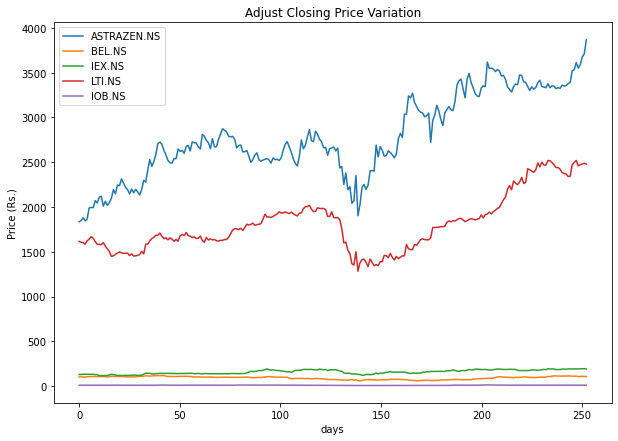

In [43]:
#Stocks Analysis - Adj Close price variation
plt.figure(figsize=(10, 7))
for stk in choosen_data['stock']:
    plt.plot(np.linspace(start=0,stop=time_duration,num=len(data_2[data_2.stock==stk])),data_2[data_2.stock==stk]['Adj Close'],label=stk)
plt.xlabel('days')
plt.ylabel('Price (Rs.)')
plt.title('Adjust Closing Price Variation')
plt.legend()

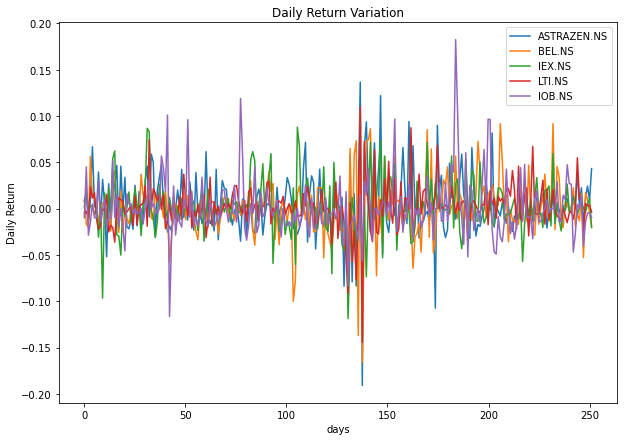

In [44]:
#Stocks Analysis - Daily Return
plt.figure(figsize=(10, 7))
for stk in choosen_data['stock']:
    plt.plot(np.linspace(start=0,stop=time_duration-1,num=len(data_3)),data_3[stk],label=stk)
plt.xlabel('days')
plt.ylabel('Daily Return')
plt.title('Daily Return Variation')
plt.legend()

In [45]:
#Getting the covariance matrix
cov_data = pd.DataFrame(data=data_3,columns=final_stock)
cov_data = cov_data.transpose()
#print(cov_data.shape)
cov_data = np.cov(cov_data)
print(cov_data*(time_duration))

[[0.28464655 0.07644982 0.02011406 0.07900356 0.03354885]
 [0.07644982 0.25818496 0.05339853 0.05142738 0.07025656]
 [0.02011406 0.05339853 0.20053913 0.02627302 0.05272718]
 [0.07900356 0.05142738 0.02627302 0.14542003 0.03066827]
 [0.03354885 0.07025656 0.05272718 0.03066827 0.24229997]]


In [46]:
#Random Portfolio Generation
fixed_rate = 3.59/100
sharpe_ratio = []
weights_record = []
ret_record = []
vol_record = []
for i in range(200000) :
    weights = np.random.random(len(choosen_data))
    weights /= np.sum(weights)
    ret = weights.dot(annual_return)
    std = np.sqrt(time_duration)*(weights.dot(cov_data.dot(weights.transpose())))**0.5
    sharpe_ratio.append((ret-fixed_rate)/std)
    weights_record.append(weights)
    ret_record.append(ret)
    vol_record.append(std)
    
complete_portfolio = pd.DataFrame()
complete_portfolio['sharpe ratio'] = sharpe_ratio
complete_portfolio['return'] = ret_record
complete_portfolio['volatility'] = vol_record
#print(ret_record)
#print(vol_record)

In [47]:
#minimum volatility portfolio
portfolio = pd.DataFrame()
index = vol_record.index(np.min(vol_record))
portfolio['weights'] = weights_record[index]
portfolio['stock'] = final_stock
minvol_ret = ret_record[index]
minvol_vol = vol_record[index]
portfolio

,weights,stock
0,0.110819,ASTRAZEN.NS
1,0.100977,BEL.NS
2,0.255343,IEX.NS
3,0.351807,LTI.NS
4,0.181054,IOB.NS


In [48]:
#max sharpe ratio/risk adjusted return portfolio
portfolio = pd.DataFrame()
index = sharpe_ratio.index(np.max(sharpe_ratio))
portfolio['weights'] = weights_record[index]
portfolio['stock'] = final_stock
maxsharpe_ret = ret_record[index]
maxsharpe_vol = vol_record[index]
portfolio

,weights,stock
0,0.579314,ASTRAZEN.NS
1,0.000939,BEL.NS
2,0.231411,IEX.NS
3,0.171576,LTI.NS
4,0.016761,IOB.NS


In [49]:
#Obtaining the effective frontier line
frontier_ret = [minvol_ret]
frontier_vol = [minvol_vol]
for i in np.linspace(start=minvol_vol,stop=maxsharpe_vol,num=50):
    frontier_data = complete_portfolio[(complete_portfolio.volatility < i+0.001) & (complete_portfolio.volatility > i-0.001)]
    index = list(frontier_data['sharpe ratio']).index(np.max(frontier_data['sharpe ratio']))
    f_ret = list(frontier_data['return'])[index]
    f_vol = list(frontier_data['volatility'])[index]
    frontier_ret.append(f_ret)
    frontier_vol.append(f_vol)
frontier_ret.append(np.max(annual_return))
frontier_vol.append(volatility[annual_return.index(np.max(annual_return))])

In [50]:
#Performing a polynomial fit on the effective frontier
z = np.polyfit(frontier_vol,frontier_ret,6)
fit_ret = []
for vol in frontier_vol :
    new_ret = 0
    for i in range(len(z)) :
        new_ret += z[i]*(vol**(len(z)-i-1))
    fit_ret.append(new_ret)

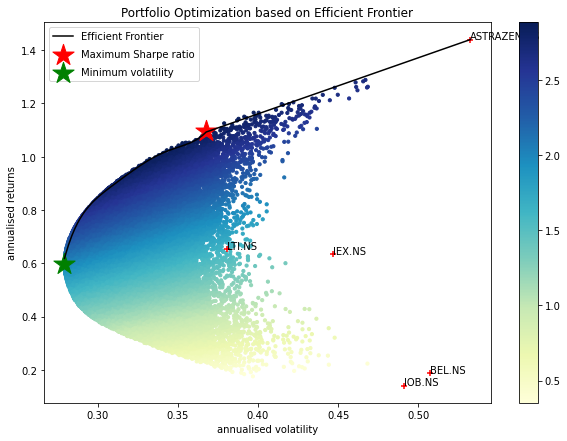

In [51]:
#Plotting Portfolio results along with efficient frontier
plt.figure(figsize=(10, 7))
plt.scatter(vol_record,ret_record,c=sharpe_ratio,cmap='YlGnBu',s=10)
plt.colorbar()
plt.plot(frontier_vol,fit_ret,linestyle='-',color='black',label='Efficient Frontier')
plt.scatter(maxsharpe_vol,maxsharpe_ret,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
plt.scatter(minvol_vol,minvol_ret,marker='*',color='g',s=500, label='Minimum volatility')
plt.scatter(volatility,annual_return,marker='+',color='r')
for i, txt in enumerate(final_stock):
    plt.annotate(txt, (volatility[i], annual_return[i]))
plt.title('Portfolio Optimization based on Efficient Frontier')
plt.xlabel('annualised volatility')
plt.ylabel('annualised returns')
plt.legend(labelspacing=0.8)

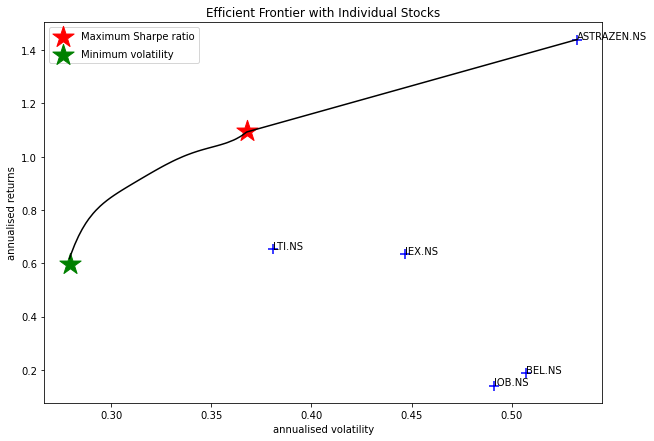

In [52]:
#Plotting Efficient Frontier with individual stocks
plt.figure(figsize=(10, 7))
plt.plot(frontier_vol,fit_ret,linestyle='-',color='black')
plt.scatter(maxsharpe_vol,maxsharpe_ret,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
plt.scatter(minvol_vol,minvol_ret,marker='*',color='g',s=500, label='Minimum volatility')
plt.scatter(volatility,annual_return,marker='+',color='b',s=100)
for i, txt in enumerate(final_stock):
    plt.annotate(txt, (volatility[i], annual_return[i]))
plt.title('Efficient Frontier with Individual Stocks')
plt.xlabel('annualised volatility')
plt.ylabel('annualised returns')
plt.legend(labelspacing=0.8)